# SETUP

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import time 
import random
from PIL import Image
import seaborn as sns
import pandas as pd
from matplotlib.collections import PathCollection

import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms, models
from torchvision.models import resnet18, ResNet18_Weights
from torch.utils.data import Dataset, Subset, DataLoader
from torchvision.datasets import MNIST, CIFAR10, CelebA

import tensorflow as tf
import tensorflow_datasets as tfds

from sklearn.metrics import f1_score

from ModelWrappers import *
from ImageSegmentationWrappers import *
from SEDCTExplainer import *


random.seed(42)
np.random.seed(42)
torch.manual_seed(42)
tf.random.set_seed(42)

device = torch.device(
    "mps" if torch.backends.mps.is_available() 
    else "cuda" if torch.cuda.is_available() 
    else "cpu"
)

### Datasets

In [2]:
# ------------------------------------------
# MNIST binary dataset wrapper
# ------------------------------------------

class BinaryMNIST(Dataset):
    def __init__(self, root, class0=3, class1=8, train=True, download=True, transform=None):
        self.base_dataset = MNIST(root=root, train=train, download=download)
        self.transform = transform
        targets = torch.tensor(self.base_dataset.targets)
        mask = (targets == class0) | (targets == class1)
        self.indices = mask.nonzero().squeeze()
        self.labels = targets[self.indices]
        # Relabel to 0 / 1
        self.labels = (self.labels == class1).long()

    def __len__(self):
        return len(self.indices)

    def __getitem__(self, idx):
        image, _ = self.base_dataset[self.indices[idx]]
        label = self.labels[idx]
        if self.transform:
            image = self.transform(image)
        return image, label

# ------------------------------------------
# CIFAR-10 binary dataset wrapper
# ------------------------------------------

class BinaryCIFAR10(Dataset):
    def __init__(self, root, class0=0, class1=2, train=True, download=True, transform=None):
        """
        Default: class0 = airplane (0), class1 = bird (2)
        """
        self.base_dataset = CIFAR10(root=root, train=train, download=download)
        self.transform = transform
        targets = torch.tensor(self.base_dataset.targets)
        mask = (targets == class0) | (targets == class1)
        self.indices = mask.nonzero().squeeze()
        self.labels = targets[self.indices]
        self.labels = (self.labels == class1).long()

    def __len__(self):
        return len(self.indices)

    def __getitem__(self, idx):
        image, _ = self.base_dataset[self.indices[idx]]
        label = self.labels[idx]
        if self.transform:
            image = self.transform(image)
        return image, label

# ------------------------------------------
# Cats vs Dogs from TFDS
# ------------------------------------------

class CatsVsDogsTFDS(Dataset):
    def __init__(self, split='train', transform=None):
        """
        TFDS 'cats_vs_dogs': label 0 = Cat, 1 = Dog
        """
        self.tf_dataset = tfds.load('cats_vs_dogs', split=split, shuffle_files=True, as_supervised=True)
        self.data = list(tfds.as_numpy(self.tf_dataset))
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        image, label = self.data[idx]
        # Convert to torch Tensor
        image = torch.tensor(image).permute(2, 0, 1).float() / 255.0  # RGB [0, 1]
        if self.transform:
            image = self.transform(image)
        label = torch.tensor(label).long()
        return image, label

### Collect the data

In [3]:
def test(IMAGES_LIST, MODEL_WRAPPER, N_SEGMENTS_LIST, N_MAX_ITERS_LIST, grayscale=False):
    data = {
        "image":            [],
        "num_segments":     [],
        "max_iters":        [],
        "time":             [],
        "segmentation":     [],
        "counterfactual":   [],
        "has_solution":     []
    }

    print(f"Processing on {N_IMG} images. #########################")
    
    for i in range(len(IMAGES_LIST)):
        image = IMAGES_LIST[i]

        range_1 = len(N_SEGMENTS_LIST)
        range_2 = len(N_MAX_ITERS_LIST)
        for idx in range(range_1):
            num_seg = N_SEGMENTS_LIST[idx]

            if grayscale:
                img_wrapper = TorchImageSegmentation(image=image,
                                                    segmentation_method='slic',
                                                    fill_method='fill',
                                                    n_segments=num_seg,
                                                    channel_axis=None)
            else: 
                img_wrapper = TorchImageSegmentation(image=image,
                                                    segmentation_method='slic',
                                                    fill_method='fill',
                                                    n_segments=num_seg)
            
            img_wrapper.compute_segmentation()

            cnn_mnist_explainer = SEDCTExplainer(classifier=MODEL_WRAPPER,
                                                 image_segmentation=img_wrapper)

            for ii in range(range_2):
                data["image"].append(image)
                data["num_segments"].append(num_seg)
                data["segmentation"].append(img_wrapper.get_segmented_image())

                max_iter = N_MAX_ITERS_LIST[ii]
                data["max_iters"].append(max_iter)

                start = time.perf_counter()
                cnn_mnist_explainer.explain_instance(max_iter=max_iter)
                end = time.perf_counter()

                data["time"].append(end - start)

                try:
                    edc = cnn_mnist_explainer.get_counterfactual()
                except Exception as e:
                    edc = None
                data["counterfactual"].append(edc)

                if edc is None:
                    data["has_solution"].append(False)
                else:
                    data["has_solution"].append(True)

                print(f"Image #{i+1}: item {idx * range_2 + ii + 1}/{range_1 * range_2} done. ")
                
    return data

### Boxplots

In [4]:
["#8ecae6","#219ebc","#023047","#ffb703","#fb8500"]
["#003049","#d62828","#f77f00","#fcbf49","#eae2b7"]
["#f2e422","#f2cb05","#f2b705","#2e933c","#297045"]

['#f2e422', '#f2cb05', '#f2b705', '#2e933c', '#297045']

In [5]:
def box_plot_all(df, name, exclude_timeout=False):
    if exclude_timeout:
        dataset = df[df['timeout_reached'] != True].copy().reset_index(drop=True)
    else: 
        dataset = df.copy()
    
    sns.set_style("whitegrid")
    n_rows = len(dataset)

    palette = ["#a6cee3", "#1f78b4", "#08306b"]

    order = [0.3, 0.6, -1.0]
    dataset['max_iters_cat'] = pd.Categorical(dataset['max_iters'], categories=order, ordered=True)

    #Figure size
    plt.figure(figsize=(12, 6))

    # Box plot
    ax = sns.boxplot(x="num_segments", 
                     y="time", 
                     hue="max_iters_cat", 
                     data=dataset,
                     dodge=True,
                     hue_order=order,
                     palette=palette)
    
    handles1, labels1 = ax.get_legend_handles_labels()
    legend1 = ax.legend(handles1, labels1, title="max_iters", loc="upper left")

    # determine how far apart the hue‐boxes are within each category
    hue_levels = order
    n_hue = len(hue_levels)
    total_width = 0.8
    single_width = total_width / n_hue
    # offsets from the center of each tick
    offsets = np.linspace(
        -total_width/2 + single_width/2,
        total_width/2 - single_width/2,
        n_hue)

    # numeric x positions of your categories
    xticks = ax.get_xticks()
    # make sure categories are in the same order as the ticks
    categories = sorted(dataset["num_segments"].unique())

    # now loop over each (category, hue) pair and scatter your points
    scatter_handles = []
    for i, cat in enumerate(categories):
        for j, hue in enumerate(hue_levels):
            sub = dataset[(dataset["num_segments"] == cat) & (dataset["max_iters_cat"] == hue)]
            if sub.empty:
                continue
            x_pos = xticks[i] + offsets[j]
            # separate true/false
            true_mask = sub["has_solution"]
            false_mask = ~true_mask

            jitter_strength = 0.008
            # blue circles for correct (has_solution==True)
            h_true = ax.scatter(
                x_pos + np.random.normal(0, jitter_strength, true_mask.sum()),
                sub.loc[true_mask, "time"],
                marker="o",
                color="#1B8D48",
                label="has_solution=True",
                zorder=10,
                s=20
            )

            # red Xs (has_solution == False)
            h_false = ax.scatter(
                x_pos + np.random.normal(0, jitter_strength, false_mask.sum()),
                sub.loc[false_mask, "time"],
                marker="x",
                color="#CB2D22",
                label="has_solution=False",
                zorder=10,
                s=26
            )
            scatter_handles += [h_true, h_false]

    # Second legend
    legend2 = ax.legend(handles=scatter_handles[:2],
                        labels=["Yes", "No"],
                        title="Counterfactual\nfound",
                        loc="upper right")

    # re-add the first legend so it stays visible
    ax.add_artist(legend1)

    # Add a title
    if exclude_timeout:
        plt.title(f"Box Plot for {name} dataset. \n"
                  f"Time took with different number of segments and maximum iteations. \n"
                  f"(Timeout runs excluded  -  Total runs: {n_rows})")
    else:
        plt.title(f"Box Plot for {name} dataset. \n"
                  f"Time took with different number of segments and maximum iteations. \n"
                  f"(Total runs: {n_rows})")

    # Add labels to the axes
    plt.xlabel("Number of segments")
    plt.ylabel("Time (in seconds)")

    # Show the plot
    plt.show()

In [6]:
def box_plot_successfull(dataset, name):
    dataset_succ = dataset[dataset['has_solution'] != False].copy().reset_index(drop=True)
    n_rows_og = len(dataset)
    n_rows_succ = len(dataset_succ)

    palette = ["#a6cee3", "#1f78b4", "#08306b"]

    order = [0.3, 0.6, -1]
    dataset_succ['max_iters_cat'] = pd.Categorical(dataset_succ['max_iters'], categories=order, ordered=True)

    sns.set_style("whitegrid")

    #Figure size
    plt.figure(figsize=(12, 6))

    # Box plot
    ax = sns.boxplot(x="num_segments", 
                     y="time", 
                     hue="max_iters_cat", 
                     data=dataset_succ,
                     dodge=True,
                     hue_order=order,
                     palette=palette)
    
    ax = sns.swarmplot(x="num_segments", 
                       y="time", 
                       hue="max_iters_cat", 
                       data=dataset_succ,
                       dodge=True,
                       hue_order=order,
                       palette='dark:#3E9B3B',
                       legend=False,
                       size=4)

    # Add a title
    plt.title(f"Box Plot for {name} dataset. \n"
              f"Time took with different number of segments and maximum iteations. \n"
              f"(Only succesful runs: {n_rows_succ}/{n_rows_og}  ~  {n_rows_succ/n_rows_og * 100 :.1f}%)")

    # Add labels to the axes
    plt.xlabel("Number of segments")
    plt.ylabel("Time (in seconds)")

    # Show the plot
    plt.show()

### Histograms

In [32]:
def hist_solved_unsolved(dataset, name):
    # NEW DF 
    tmp = dataset[['has_solution', 'max_iters']].copy()
    tmp = tmp[tmp['max_iters'] == -1]

    
    # HISTOGRAM 
    solved =    (tmp['has_solution'])
    unsolved = (~tmp['has_solution'])

    counts = {
        'Solved':         solved.sum(),
        'Unsolved':     unsolved.sum()
    }

    # Plot
    labels = list(counts.keys())
    values = list(counts.values())
    
    plt.figure(figsize=(4,5))
    bars = plt.bar(labels, values, color=["#1B8D48", '#CB2D22'])
    plt.bar_label(bars)
    plt.ylabel('Number of images')
    plt.title(f'Histogram for {name}.\nSolved vs Unsolved (max_iter=-1)')
    plt.xticks()
    plt.tight_layout()
    plt.grid(axis='x')
    plt.show()

In [8]:
def hist_sol_with_greater_max_iter(data, name, exclude_timeout=False):
    if exclude_timeout:
        dataset = data[data['timeout_reached'] != True].reset_index(drop=True)
    else: 
        dataset = data
    
    # NEW DF 
    tmp = dataset[['image', 'max_iters', 'has_solution', 'num_segments']].copy()
    tmp['img_key'] = tmp['image'].apply(id)
    tmp['group_id'] = tmp.groupby(['img_key', 'num_segments']).ngroup()
    
    # pivot so max_iters values become columns, and has_solution the values, per each row image
    df = tmp.pivot(index='group_id',
                   columns='max_iters',
                   values='has_solution')
    df.rename(columns={
        0.3:  'has_sol_03',
        0.6:  'has_sol_06',
        -1:   'has_sol_-1'
    }, inplace=True)
    df.reset_index()

    df.fillna(False, inplace=True)

    # HISTOGRAM
    # Define each category
    cat1 = (~df['has_sol_03']) & (df['has_sol_06'])
    cat2 = (~df['has_sol_03']) & (~df['has_sol_06']) & (df['has_sol_-1'])
    cat3 = (~df['has_sol_03']) & (~df['has_sol_-1'])
    
    # Count
    counts = {
        'Solved with\nmax_iter=0.6'             : cat1.sum(),
        'Solved with\nmax_iter=-1'              : cat2.sum(),
        'Not solved'                            : cat3.sum(),
    }
    
    # Plot
    labels = list(counts.keys())
    values = list(counts.values())
    
    plt.figure(figsize=(5,5))
    bars = plt.bar(labels, values, color=["#1B8D48", "#1B8D48", "#CB2D22"])
    plt.bar_label(bars)
    plt.ylabel('Number of images')
    if exclude_timeout:
        plt.title(f'Histogram for {name}.\nInitially unsolved, then: \n'
                  f'(Timeout runs excluded)')
    else:
        plt.title(f'Histogram for {name}.\nInitially unsolved, then: ')
    plt.xticks()
    plt.tight_layout()
    plt.grid(axis='x')
    plt.show()

In [36]:
def hist_run_timedout(dataset, name):
    # NEW DF 
    tmp = dataset[['timeout_reached']].copy()
    
    # HISTOGRAM 
    solved =   (~tmp['timeout_reached'])
    unsolved =  (tmp['timeout_reached'])

    counts = {
        'Completed runs':        solved.sum(),
        'Timeout reached':     unsolved.sum()
    }

    # Plot
    labels = list(counts.keys())
    values = list(counts.values())
    
    plt.figure(figsize=(4,5))
    bars = plt.bar(labels, values, color=["#0682a1", "#ee7f00"])
    plt.bar_label(bars)
    plt.ylabel('Number of images')
    plt.title(f'Histogram for {name}.\nFinished vs timeout runs')
    plt.xticks()
    plt.tight_layout()
    plt.grid(axis='x')
    plt.show()

### Counterfactuals + segmentations

In [10]:
def visualize_dataset(dataset, only_med=False):
    # build a new dataset
    dataset_2 = dataset[dataset['max_iters'] == -1].copy()
    dataset_2['_img_key'] = dataset_2['image'].apply(id)

    rows = []
    for img_idx, grp in dataset_2.groupby('_img_key'):
        try:
            base_img = grp.iloc[0]['image']
            base_img.numpy()
        except:
            base_img = np.array(grp.iloc[0]['image'])
        grp_sorted = grp.sort_values('num_segments').reset_index(drop=True)
        
        if not only_med:
            row = {'image': base_img}
            for idx, (_, entry) in enumerate(grp_sorted.iterrows()):
                row[f'num_segments_{idx}']    = entry['num_segments']
                row[f'segmentation_{idx}']    = entry['segmentation']
                row[f'counterfactual_{idx}']  = entry['counterfactual']
                row[f'time_{idx}']            = entry['time']
            rows.append(row)
            
        else:
            n = len(grp_sorted)
            i_min, i_med, i_max = 0, n // 2, n - 1
            r_min = grp_sorted.loc[i_min]
            r_med = grp_sorted.loc[i_med]
            r_max = grp_sorted.loc[i_max]

            rows.append({
                'image': base_img,
                # minimum
                'num_segments_0':    r_min['num_segments'],
                'segmentation_0':    r_min['segmentation'],
                'counterfactual_0':  r_min['counterfactual'],
                'time_0':             r_min['time'],
                # median
                'num_segments_1':    r_med['num_segments'],
                'segmentation_1':    r_med['segmentation'],
                'counterfactual_1':  r_med['counterfactual'],
                'time_1':            r_med['time'],
                # maximum
                'num_segments_2':    r_max['num_segments'],
                'segmentation_2':    r_max['segmentation'],
                'counterfactual_2':  r_max['counterfactual'],
                'time_2':            r_max['time'],
            })

    return pd.DataFrame(rows)

In [11]:
def visualize_img_seg_edc(img_id, dataset, grayscale=False):
    row = dataset.iloc[img_id]
    indexes = [i for i in range(int((len(row) - 1) / 4))]

    base = row['image']
    segs = [row[f"segmentation_{idx}"] for idx in indexes]
    time = [row[f"time_{idx}"] for idx in indexes]
    n_segments = [row[f"num_segments_{idx}"] for idx in indexes]

    cfs = []
    for idx in indexes:
        cf = row[f"counterfactual_{idx}"]
        if cf is None:
            cfs.append(np.zeros_like(base))
        else:
            cfs.append(cf)

    # Figure
    fig = plt.figure(figsize=(16, 6))
    ratio = [2] + [1] * (len(indexes) )
    gs = fig.add_gridspec(2, len(indexes)+1, width_ratios=ratio, wspace=0.05, hspace=0.05)

    ax = fig.add_subplot(gs[:, 0])
    try:
        if grayscale:
            ax.imshow(base, cmap='gray')
        else:
            ax.imshow(base)
    except:
        ax.imshow(base.permute(1,2,0))
    ax.set_title("Base Image")
    ax.axis("off")

    for i, seg in enumerate(segs):
        ax = fig.add_subplot(gs[0, i + 1])
        ax.imshow(seg.permute(1,2,0))
        ax.set_title(f"Number of\nsegments set: {n_segments[i]}")
        ax.axis("off")

    for i, cf_img in enumerate(cfs):
        ax = fig.add_subplot(gs[1, i + 1])
        if grayscale:
            try:
                ax.imshow(cf_img, cmap='gray')
            except:
                ax.imshow(cf_img.permute(1,2,0), cmap='gray')
        else:
            try:
                ax.imshow(cf_img.permute(1,2,0))
            except:
                try:
                    ax.imshow(cf_img)
                except:
                    ax.imshow(cf_img.transpose(1,2,0))
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_xlabel(f"Time: {time[i]:.2f}", fontsize=12, labelpad=15)

    plt.show()

# MODELS TRAINING 

## CNN for MNIST 

### Model and transformation

In [34]:
# Simple CNN
class SimpleMNISTCNN(nn.Module):
    def __init__(self):
        super(SimpleMNISTCNN, self).__init__()
        
        self.conv1 = nn.Conv2d(1, 32, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, padding=1)
        
        self.fc1 = nn.Linear(64 * 7 * 7, 128)
        self.fc2 = nn.Linear(128, 1)  # binary output
        
        self.pool = nn.MaxPool2d(2, 2)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = x.view(x.size(0), -1)
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x.squeeze(1)

In [35]:
transform_mnist = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

### Train and test

In [36]:
train_ds = BinaryMNIST(root='./data', class0=3, class1=8, train=True, transform=transform_mnist)
test_ds = BinaryMNIST(root='./data', class0=3, class1=8, train=False, transform=transform_mnist)

train_loader = DataLoader(train_ds, batch_size=64, shuffle=True)
test_loader = DataLoader(test_ds, batch_size=64, shuffle=False)

/var/folders/vx/wsv0__k15g37xmltv38_43l80000gn/T/ipykernel_40720/3617924654.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  targets = torch.tensor(self.base_dataset.targets)


In [6]:
model = SimpleMNISTCNN().to(device)
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [7]:
num_epochs = 5

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for images, labels in train_loader:
        images = images.to(device)
        labels = labels.to(device).float()  # BCE expects float labels

        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * images.size(0)

    epoch_loss = running_loss / len(train_loader.dataset)
    print(f"Epoch [{epoch+1}/{num_epochs}] - Train Loss: {epoch_loss:.4f}")

Epoch [1/5] - Train Loss: 0.1028
Epoch [2/5] - Train Loss: 0.0171
Epoch [3/5] - Train Loss: 0.0098
Epoch [4/5] - Train Loss: 0.0051
Epoch [5/5] - Train Loss: 0.0049


In [ ]:
#model = SimpleMNISTCNN()
#model.load_state_dict(torch.load('./Models/mnist_binary_cnn.pth'))
#model = model.to(device)
model.eval()
all_preds = []
all_labels = []

with torch.no_grad():
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images)
        probs = torch.sigmoid(outputs)
        preds = (probs > 0.5).int()
        
        all_preds.extend(preds.view(-1).cpu().tolist())
        all_labels.extend(labels.view(-1).cpu().tolist())

# Compute accuracy
correct = sum(p == t for p, t in zip(all_preds, all_labels))
total = len(all_labels)
accuracy = correct / total

# Compute F1 score
f1 = f1_score(all_labels, all_preds)

print(f"Test Accuracy: {accuracy}")
print(f"Test F1 Score: {f1}")

Test Accuracy: 0.998991935483871
Test F1 Score: 0.9989743589743589


In [10]:
torch.save(model.state_dict(), './saved_models/mnist_binary_cnn.pth')
print("Model saved to ./saved_models/mnist_binary_cnn.pth")

Model saved to ./saved_models/mnist_binary_cnn.pth


## RESNET-18 for CIFAR10 

### Model and transformation

In [40]:
model = models.resnet18(weights=ResNet18_Weights.DEFAULT)
model.fc = nn.Linear(model.fc.in_features, 1) 

In [41]:
transform_cifar10 = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=(0.485, 0.456, 0.406),
        std=(0.229, 0.224, 0.225)
    )
])

### Train and test

In [42]:
train_ds = BinaryCIFAR10(root='./data', class0=0, class1=2, train=True, transform=transform_cifar10)
test_ds = BinaryCIFAR10(root='./data', class0=0, class1=2, train=False, transform=transform_cifar10)

train_loader = DataLoader(train_ds, batch_size=64, shuffle=True)
test_loader = DataLoader(test_ds, batch_size=64, shuffle=False)

In [20]:
model = model.to(device)  
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0005)

In [21]:
num_epochs = 5

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    for images, labels in train_loader:
        images = images.to(device)
        labels = labels.to(device).float()

        optimizer.zero_grad()
        outputs = model(images).squeeze(1)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * images.size(0)

    epoch_loss = running_loss / len(train_loader.dataset)
    print(f"Epoch [{epoch+1}/{num_epochs}] - Train Loss: {epoch_loss:.4f}")

Epoch [1/5] - Train Loss: 0.0855


KeyboardInterrupt: 

In [ ]:
model.eval()
correct = 0
total = 0

with torch.no_grad():
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images).squeeze(1)
        preds = torch.sigmoid(outputs) > 0.5
        correct += (preds.int() == labels).sum().item()
        total += labels.size(0)

accuracy = correct / total
print(f"Test Accuracy: {accuracy * 100:.2f}%")

Test Accuracy: 97.15%


In [ ]:
#model = models.resnet18(weights=ResNet18_Weights.DEFAULT) 
#model.fc = nn.Linear(model.fc.in_features, 1) 
#model.load_state_dict(torch.load('./Models/cifar10_resnet18_binary.pth')) 
#model = model.to(device)
model.eval()

correct = 0
total = 0
all_preds = []
all_labels = []

with torch.no_grad():
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images).squeeze(1)
        probs = torch.sigmoid(outputs)
        preds = (probs > 0.5).int()
        correct += (preds == labels).sum().item()
        total += labels.size(0)
        all_preds.extend(preds.cpu().tolist())
        all_labels.extend(labels.cpu().tolist())

accuracy = correct / total
f1 = f1_score(all_labels, all_preds)

print(f"Test Accuracy: {accuracy}")
print(f"Test F1 Score: {f1}")

Test Accuracy: 0.9715
Test F1 Score: 0.9715142428785607


In [ ]:
torch.save(model.state_dict(), './saved_models/cifar10_resnet18_binary.pth')
print("Model saved to ./saved_models/cifar10_resnet18_binary.pth")

Model saved to ./saved_models/cifar10_resnet18_binary.pth


## RESNET-18 for CATSvsDOGS

### Model and transform

In [6]:
model = models.resnet18(weights=ResNet18_Weights.DEFAULT)
model.fc = nn.Linear(model.fc.in_features, 1) 

In [7]:
transform_catsdogs = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.Normalize(
        mean=(0.485, 0.456, 0.406),
        std=(0.229, 0.224, 0.225)
    )])

### Train and test

In [8]:
train_ds = CatsVsDogsTFDS(split='train[:80%]', transform=transform_catsdogs)
test_ds = CatsVsDogsTFDS(split='train[80%:]', transform=transform_catsdogs)

train_loader = DataLoader(train_ds, batch_size=32, shuffle=True)
test_loader = DataLoader(test_ds, batch_size=32, shuffle=False)

2025-07-09 12:41:57.780194: I tensorflow/core/kernels/data/tf_record_dataset_op.cc:387] The default buffer size is 262144, which is overridden by the user specified `buffer_size` of 8388608
2025-07-09 12:42:05.871250: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
2025-07-09 12:42:08.526036: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


In [12]:
model = model.to(device)  
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0005)

In [13]:
num_epochs = 5

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    for images, labels in train_loader:
        images = images.to(device)
        labels = labels.to(device).float()

        optimizer.zero_grad()
        outputs = model(images).squeeze(1)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * images.size(0)

    epoch_loss = running_loss / len(train_loader.dataset)
    print(f"Epoch [{epoch+1}/{num_epochs}] - Train Loss: {epoch_loss:.4f}")

Epoch [1/5] - Train Loss: 0.1146
Epoch [2/5] - Train Loss: 0.0704
Epoch [3/5] - Train Loss: 0.0582
Epoch [4/5] - Train Loss: 0.0463
Epoch [5/5] - Train Loss: 0.0419


In [14]:
model.eval()
correct = 0
total = 0

with torch.no_grad():
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images).squeeze(1)
        preds = torch.sigmoid(outputs) > 0.5
        correct += (preds.int() == labels).sum().item()
        total += labels.size(0)

accuracy = correct / total
print(f"Test Accuracy: {accuracy * 100:.2f}%")

Test Accuracy: 96.90%


In [ ]:
#model = models.resnet18(weights=ResNet18_Weights.DEFAULT) 
#model.fc = nn.Linear(model.fc.in_features, 1) 
#model.load_state_dict(torch.load('./Models/catdogs_resnet18_binary.pth')) 
#model = model.to(device)
model.eval()

correct = 0
total = 0
all_preds = []
all_labels = []

with torch.no_grad():
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images).squeeze(1)
        probs = torch.sigmoid(outputs)
        preds = (probs > 0.5).int()
        correct += (preds == labels).sum().item()
        total += labels.size(0)
        all_preds.extend(preds.cpu().tolist())
        all_labels.extend(labels.cpu().tolist())

accuracy = correct / total
f1 = f1_score(all_labels, all_preds)

print(f"Test Accuracy: {accuracy}")
print(f"Test F1 Score: {f1}")

Test Accuracy: 0.9690455717970765
Test F1 Score: 0.9697606047879043


In [15]:
torch.save(model.state_dict(), './saved_models/catdogs_resnet18_binary.pth')
print("Model saved to ./saved_models/catdogs_resnet18_binary.pth")

Model saved to ./saved_models/celeba_resnet18_binary.pth


# SEDCT TESTS (binary classification)

For each dataset change:
- images 
- num. iterations 
- num. segments -> same segmentation algorithm

    and save:
    - the total time required for the algorithm
    - the number of iterations 
    - save the images 
    - save the images with the segments

(only for binary classification in pytorch)

## MNIST

In [6]:
N_IMG = 100
N_MAX_ITERS = [0.3, 0.6, -1]
N_SEGMENTS_MNIST = [10, 20, 30, 40]

In [7]:
class SimpleMNISTCNN(nn.Module):
    def __init__(self):
        super(SimpleMNISTCNN, self).__init__()
        
        self.conv1 = nn.Conv2d(1, 32, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, padding=1)
        
        self.pool = nn.MaxPool2d(2, 2)
        
        self.fc1 = nn.Linear(64 * 7 * 7, 128)
        self.fc2 = nn.Linear(128, 1)  # binary output
        

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = x.view(x.size(0), -1)
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x.squeeze(1)
    

transform_mnist = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

In [ ]:
# Setting the ModelWrapper
mnist_model = SimpleMNISTCNN()
mnist_model.load_state_dict(torch.load('./Models/mnist_binary_cnn.pth'))
mnist_model = mnist_model.to(device)
mnist_model.eval()

mnist_model_wrapper = TorchModelWrapper(mnist_model, transform=transform_mnist)

In [9]:
# Randomly picking 20 images
MNIST_train_set = BinaryMNIST(root='./data', class0=3, class1=8, train=True)

indices = random.sample(range(len(MNIST_train_set)), N_IMG)

small_MNIST = Subset(MNIST_train_set, indices)

imgs_MNIST = [small_MNIST[i][0] for i in range(len(small_MNIST))]

/var/folders/vx/wsv0__k15g37xmltv38_43l80000gn/T/ipykernel_40720/3617924654.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  targets = torch.tensor(self.base_dataset.targets)


In [10]:
# Collecting the data
MNIST_data = test(imgs_MNIST, mnist_model_wrapper, N_SEGMENTS_MNIST, N_MAX_ITERS, grayscale=True)

MNIST_df = pd.DataFrame(MNIST_data)

# Saving
MNIST_df.to_pickle("MNIST_df.pkl")
print("Saved!  #############################################")

Processing on 100 images. #########################
Image #1: item 1/12 done. 
Image #1: item 2/12 done. 
Image #1: item 3/12 done. 
Image #1: item 4/12 done. 
Image #1: item 5/12 done. 
Image #1: item 6/12 done. 
Image #1: item 7/12 done. 
Image #1: item 8/12 done. 
Image #1: item 9/12 done. 
Image #1: item 10/12 done. 
Image #1: item 11/12 done. 
Image #1: item 12/12 done. 
The algorithm has reached 'max_iter' value (2). No counterfactual has been found. To produce a counterfactual try to increse the 'max_iter' parameter.
Image #2: item 1/12 done. 
The algorithm has reached 'max_iter' value (5). No counterfactual has been found. To produce a counterfactual try to increse the 'max_iter' parameter.
Image #2: item 2/12 done. 
The algorithm has reached 'max_iter' value (9). No counterfactual has been found. To produce a counterfactual try to increse the 'max_iter' parameter.
Image #2: item 3/12 done. 
The algorithm has reached 'max_iter' value (7). No counterfactual has been found. To pr

## CIFAR-10

In [16]:
N_IMG = 100
N_MAX_ITERS = [0.3, 0.6, -1]
N_SEGMENTS_CIFAR10 = [10, 15, 20, 25]

In [17]:
transform_cifar10 = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=(0.485, 0.456, 0.406),
        std=(0.229, 0.224, 0.225)
    )
])

In [ ]:
# Setting the ModelWrapper
cifar10_model = models.resnet18(weights=ResNet18_Weights.DEFAULT)
cifar10_model.fc = nn.Linear(cifar10_model.fc.in_features, 1) 
cifar10_model.load_state_dict(torch.load('./Models/cifar10_resnet18_binary.pth'))
cifar10_model = cifar10_model.to(device)
cifar10_model.eval()

cifar10_model_wrapper = TorchModelWrapper(cifar10_model, transform=transform_cifar10)

In [19]:
# Randomly picking 20 images
CIFAR10_train_set = BinaryCIFAR10(root='./data', class0=0, class1=2, train=True, transform=None)

indices = random.sample(range(len(CIFAR10_train_set)), N_IMG)

small_CIFAR10 = Subset(CIFAR10_train_set, indices)

imgs_CIFAR10 = [small_CIFAR10[i][0] for i in range(len(small_CIFAR10))]

In [20]:
# Collecting the data
CIFAR10_data = test(imgs_CIFAR10, cifar10_model_wrapper, N_SEGMENTS_CIFAR10, N_MAX_ITERS)

CIFAR10_df = pd.DataFrame(CIFAR10_data)

# Saving 
CIFAR10_df.to_pickle("CIFAR10_df.pkl")
print("Saved!  #############################################")

Processing on 100 images. #########################
Image #1: item 1/12 done. 
Image #1: item 2/12 done. 
Image #1: item 3/12 done. 
Image #1: item 4/12 done. 
Image #1: item 5/12 done. 
Image #1: item 6/12 done. 
Image #1: item 7/12 done. 
Image #1: item 8/12 done. 
Image #1: item 9/12 done. 
Image #1: item 10/12 done. 
Image #1: item 11/12 done. 
Image #1: item 12/12 done. 
The algorithm has reached 'max_iter' value (2). No counterfactual has been found. To produce a counterfactual try to increse the 'max_iter' parameter.
Image #2: item 1/12 done. 
The algorithm has reached 'max_iter' value (4). No counterfactual has been found. To produce a counterfactual try to increse the 'max_iter' parameter.
Image #2: item 2/12 done. 
The algorithm has reached 'max_iter' value (7). No counterfactual has been found. To produce a counterfactual try to increse the 'max_iter' parameter.
Image #2: item 3/12 done. 
The algorithm has reached 'max_iter' value (3). No counterfactual has been found. To pr

## CatsVsDogs

In [ ]:
N_IMG = 41 # test images were picked in two rounds, the firts with 20 and the second with 21 images
N_MAX_ITERS = [0.3, 0.6, -1]
N_SEGMENTS_CATDOGS = [50, 100, 150, 200, 250]

In [11]:
transform_catsdogs = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=(0.485, 0.456, 0.406),
        std=(0.229, 0.224, 0.225)
)])

In [ ]:
# Setting the ModelWrapper
catsdogs_model = models.resnet18(weights=ResNet18_Weights.DEFAULT)
catsdogs_model.fc = nn.Linear(catsdogs_model.fc.in_features, 1) 
catsdogs_model.load_state_dict(torch.load('./Models/catdogs_resnet18_binary.pth'))
catsdogs_model = catsdogs_model.to(device)
catsdogs_model.eval()

catsdogs_model_wrapper = TorchModelWrapper(catsdogs_model, transform=transform_catsdogs)

In [101]:
# Randomly picking 20 images
CATSDOGS_train_set = CatsVsDogsTFDS(split='train[:10%]', transform=None)

indices = random.sample(range(len(CATSDOGS_train_set)), N_IMG)

small_CATSDOGS = Subset(CATSDOGS_train_set, indices)

imgs_CATSDOGS = [small_CATSDOGS[i][0] for i in range(len(small_CATSDOGS))]

2025-07-10 15:14:48.666932: I tensorflow/core/kernels/data/tf_record_dataset_op.cc:387] The default buffer size is 262144, which is overridden by the user specified `buffer_size` of 8388608
2025-07-10 15:14:49.437371: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


In [ ]:
import signal
from functools import wraps

class TimeoutException(Exception):
    """Raised when a function times out via signal.alarm."""
    pass

def timeout(seconds):
    """
    Decorator that uses SIGALRM to interrupt your function
    after `seconds`.  Works on macOS & Linux (including Colab).
    """
    def decorator(func):
        @wraps(func)
        def wrapper(*args, **kwargs):
            # install our handler
            old_handler = signal.signal(signal.SIGALRM,
                                       lambda sig, frame: (_ for _ in ()).throw(TimeoutException(f"{func.__name__} timed out after {seconds}s")))
            signal.alarm(seconds)
            try:
                return func(*args, **kwargs)
            finally:
                signal.alarm(0)                     # cancel pending alarm
                signal.signal(signal.SIGALRM, old_handler)  # restore old handler
        return wrapper
    return decorator

In [ ]:
def test(IMAGES_LIST, MODEL_WRAPPER, N_SEGMENTS_LIST, N_MAX_ITERS_LIST, grayscale=False, timeout_secs=15):
    data = {
        "image":            [],
        "num_segments":     [],
        "max_iters":        [],
        "time":             [],
        "segmentation":     [],
        "counterfactual":   [],
        "has_solution":     [],
        "timeout_reached":  []
    }

    print(f"Processing on {N_IMG} images. #########################")

    for i in range(len(IMAGES_LIST)):
        image = IMAGES_LIST[i]

        range_1 = len(N_SEGMENTS_LIST)
        range_2 = len(N_MAX_ITERS_LIST)
        for idx in range(range_1):
            num_seg = N_SEGMENTS_LIST[idx]

            if grayscale:
                img_wrapper = TorchImageSegmentation(image=image,
                                                    segmentation_method='slic',
                                                    fill_method='fill',
                                                    n_segments=num_seg,
                                                    channel_axis=None)
            else:
                img_wrapper = TorchImageSegmentation(image=image,
                                                    segmentation_method='slic',
                                                    fill_method='fill',
                                                    n_segments=num_seg)

            img_wrapper.compute_segmentation()
            print("Segmentation completed -------")

            cnn_mnist_explainer = SEDCTExplainer(classifier=MODEL_WRAPPER,
                                                 image_segmentation=img_wrapper)

            for ii in range(range_2):
                data["image"].append(image)
                data["num_segments"].append(num_seg)
                data["segmentation"].append(img_wrapper.get_segmented_image())

                max_iter = N_MAX_ITERS_LIST[ii]
                data["max_iters"].append(max_iter)
                data["timeout_reached"].append(False)

                timed_explain_instance = timeout(timeout_secs)(cnn_mnist_explainer.explain_instance)

                start = time.perf_counter()
                try:
                  timed_explain_instance(max_iter=max_iter)
                except TimeoutException:
                  data["timeout_reached"][-1] = True
                  print("TIMEOUT")
                finally:
                  end = time.perf_counter()

                data["time"].append(end - start)

                try:
                    edc = cnn_mnist_explainer.get_counterfactual()
                except Exception as e:
                    edc = None
                data["counterfactual"].append(edc)

                if edc is None:
                    data["has_solution"].append(False)
                else:
                    data["has_solution"].append(True)

                print(f"Image #{i+1}: item {idx * range_2 + ii + 1}/{range_1 * range_2} done. ")

    return data

In [ ]:
CATSDOGS_data = test(imgs_CATSDOGS, catsdogs_model_wrapper, N_SEGMENTS_CATDOGS, N_MAX_ITERS)

CATSDOGS_df = pd.DataFrame(CATSDOGS_data)

# Saving
CATSDOGS_df.to_pickle("CATSDOGS_df.pkl")
print("Saved!  #############################################")

In [11]:
len(CATSDOGS_df)

615

In [12]:
CATSDOGS_df.to_pickle("CATSDOGS_df.pkl")

# GRAPHS

## MNIST

In [12]:
# Loading dataset
MNIST_df = pd.read_pickle("Data_Collected/MNIST_df.pkl")

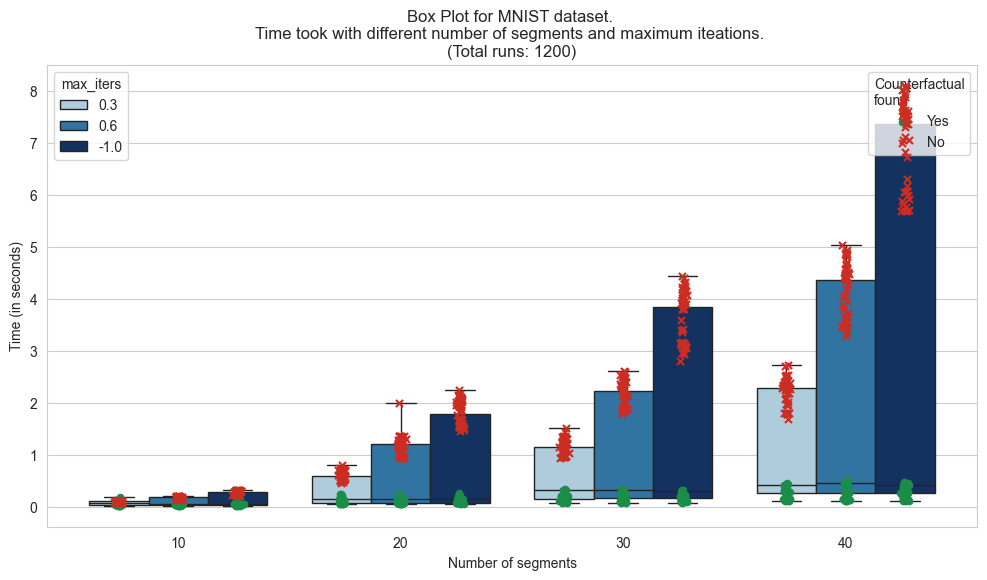

In [13]:
box_plot_all(MNIST_df, "MNIST")

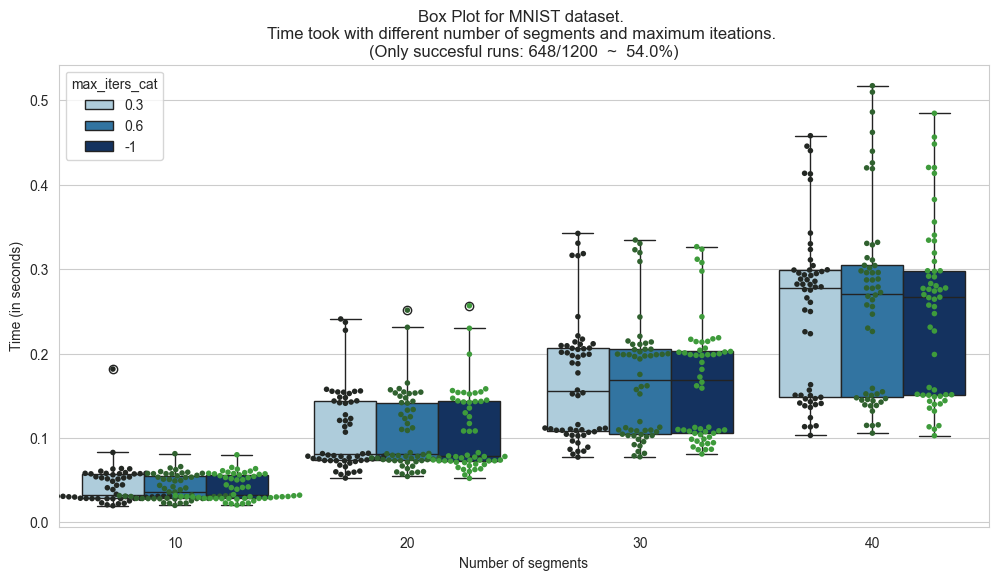

In [14]:
box_plot_successfull(MNIST_df, "MNIST")

In [18]:
MNIST_visualize_df = visualize_dataset(MNIST_df)

In [19]:
MNIST_visualize_df.shape

(100, 17)

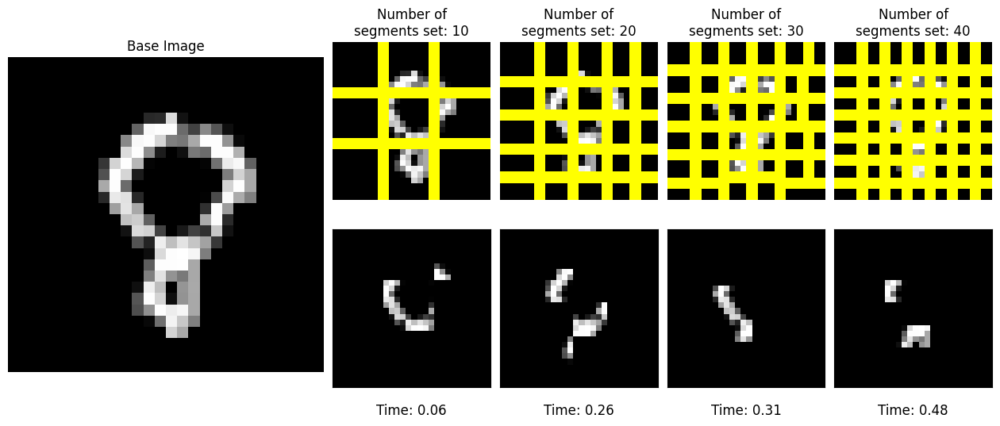

In [30]:
visualize_img_seg_edc(6, MNIST_visualize_df, grayscale=True)

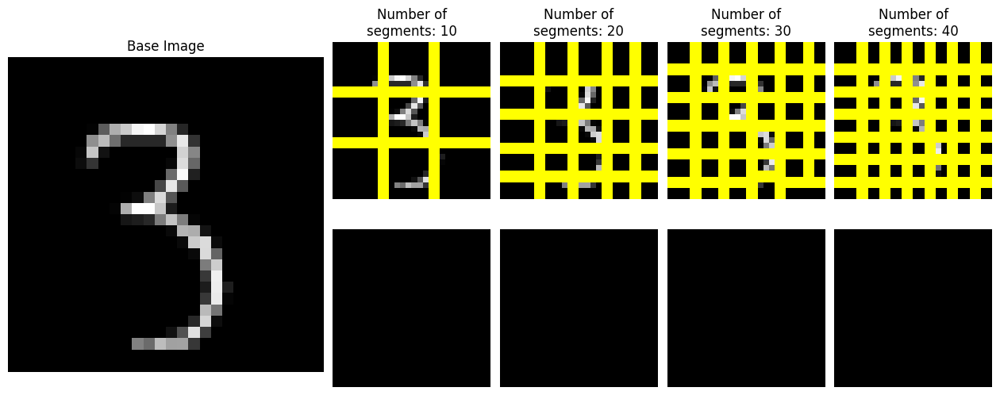

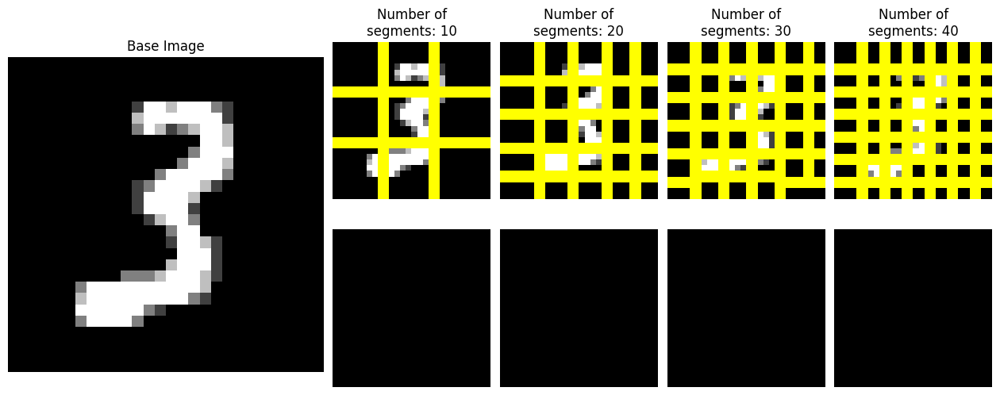

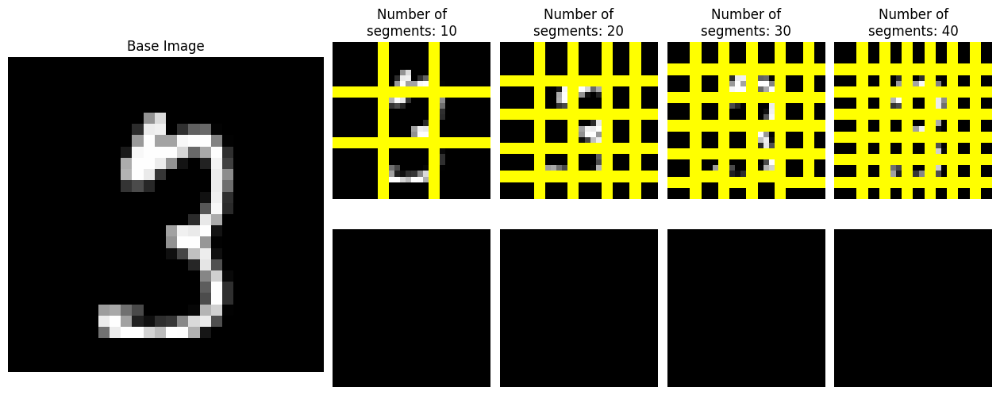

/var/folders/vx/wsv0__k15g37xmltv38_43l80000gn/T/ipykernel_45061/971181585.py:15: DeprecationWarning: __array__ implementation doesn't accept a copy keyword, so passing copy=False failed. __array__ must implement 'dtype' and 'copy' keyword arguments.
  cfs.append(np.array(cf))


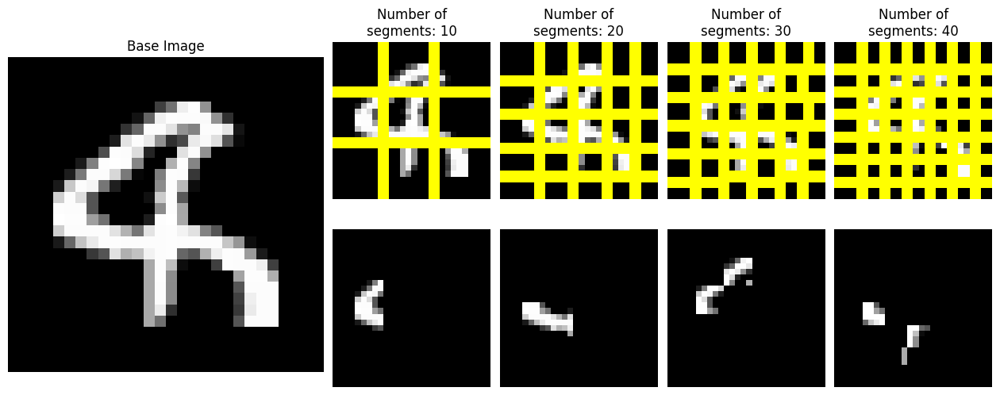

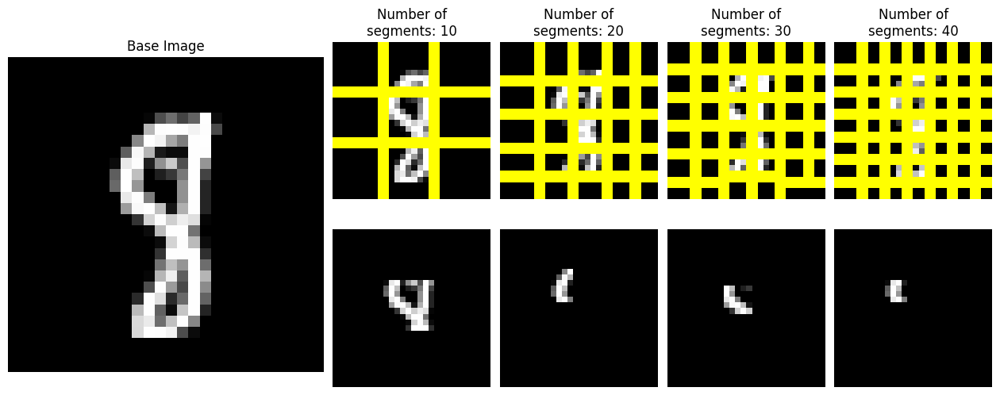

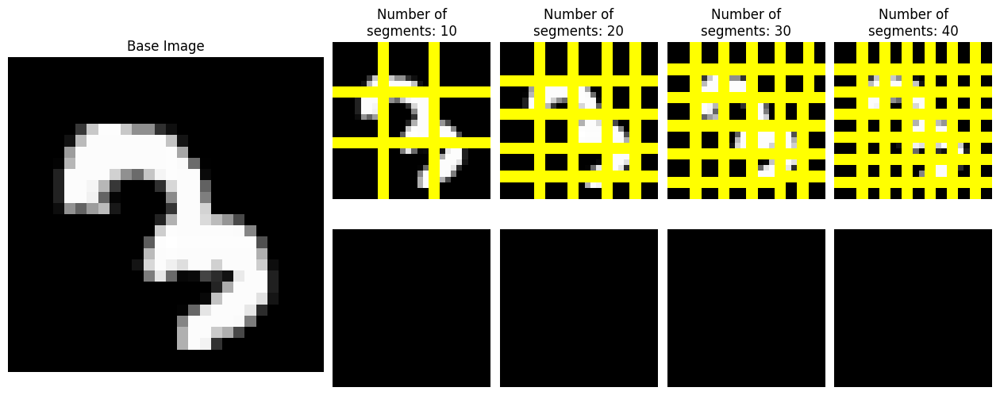

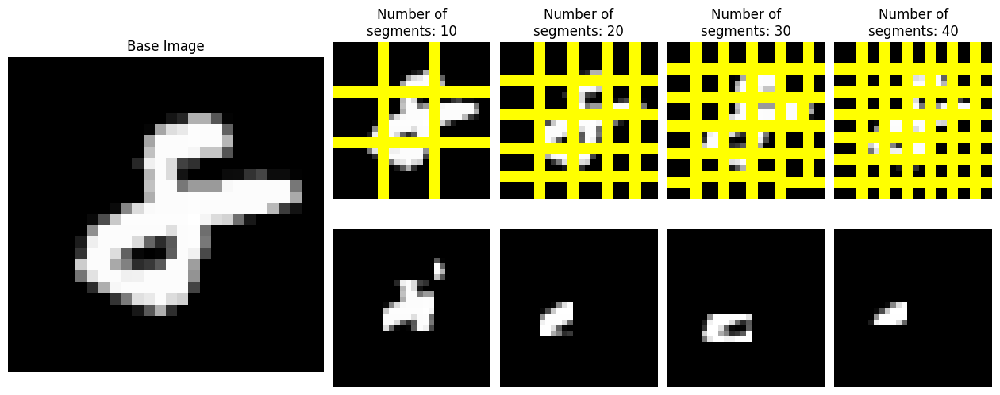

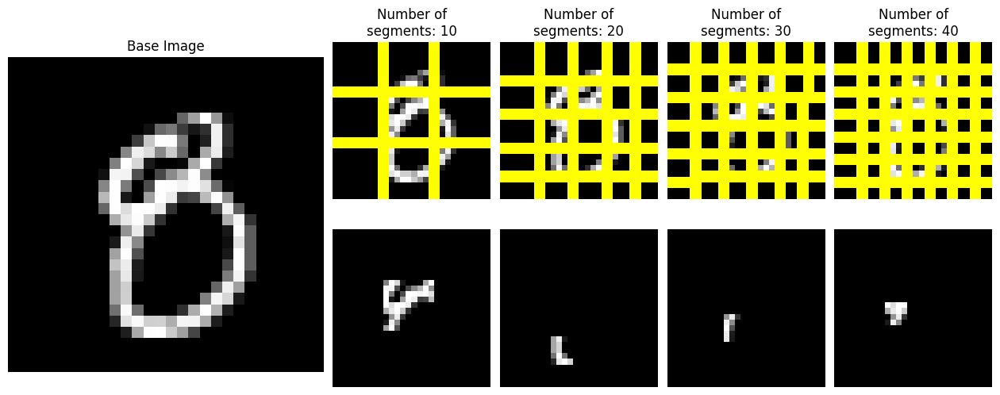

...

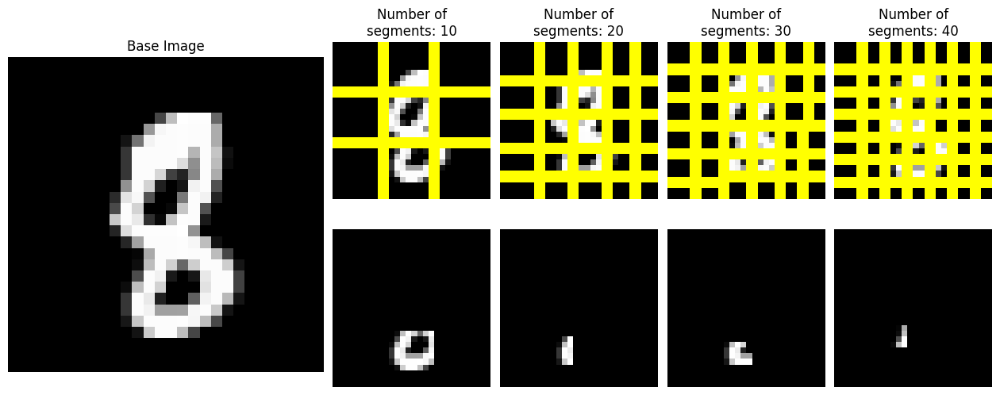

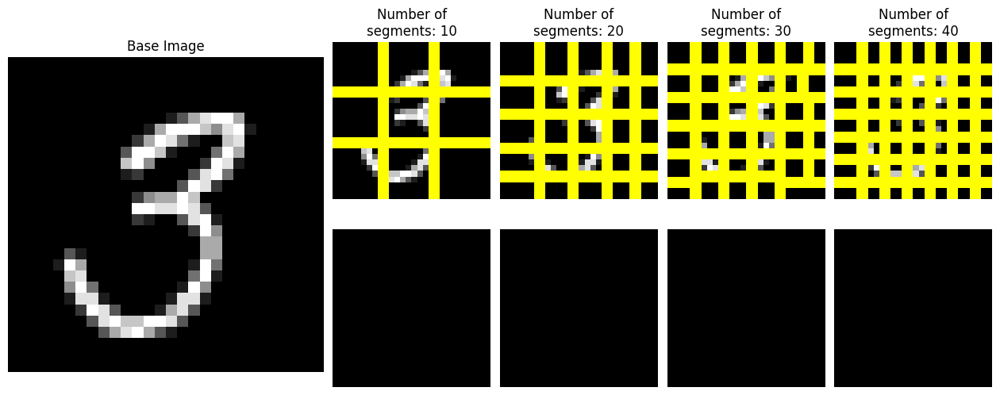

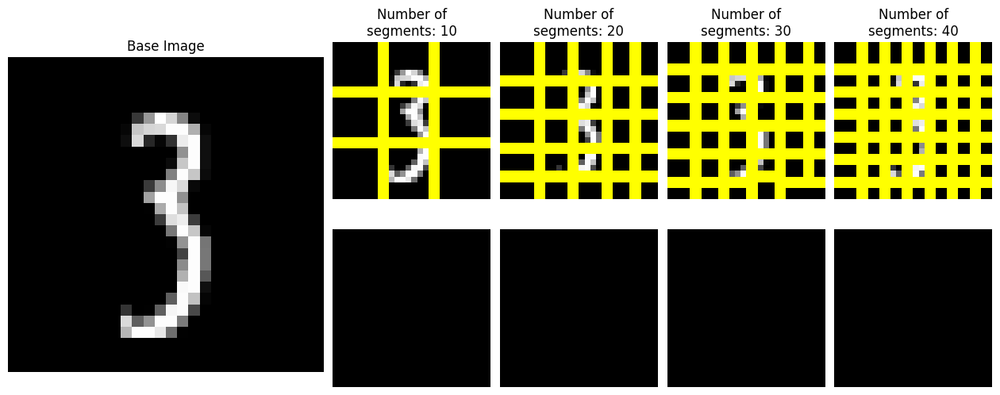

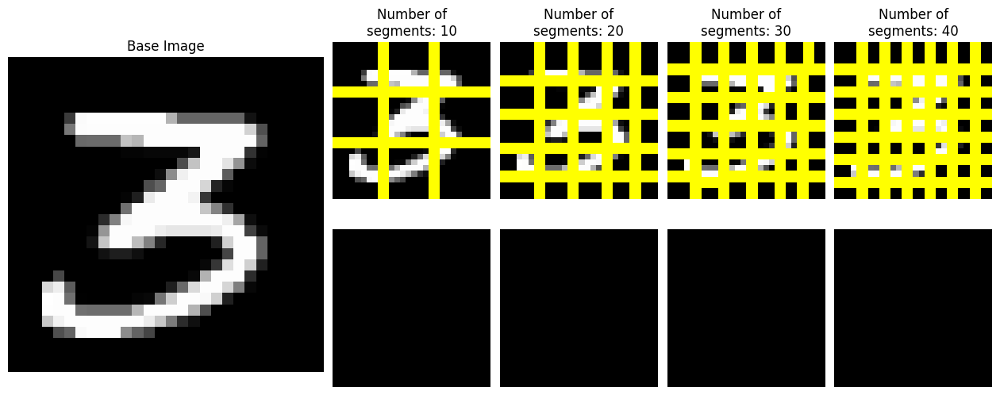

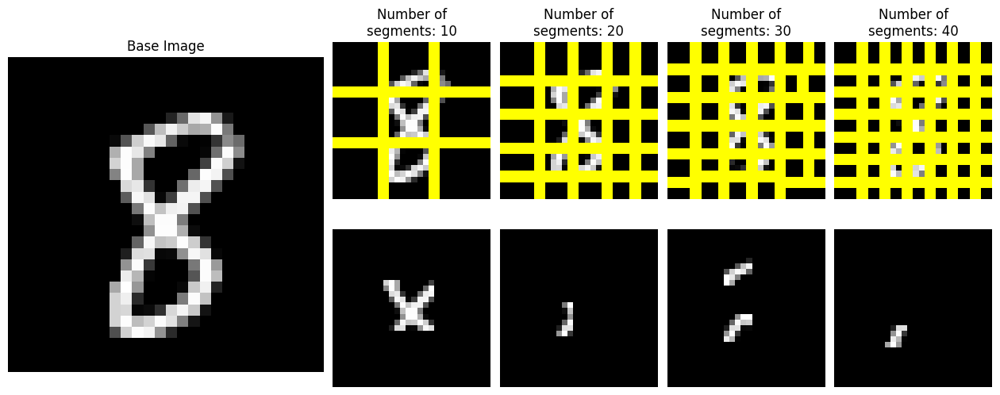

In [80]:
for i in range(20):
    visualize_img_seg_edc(i, MNIST_visualize_df, grayscale=True)

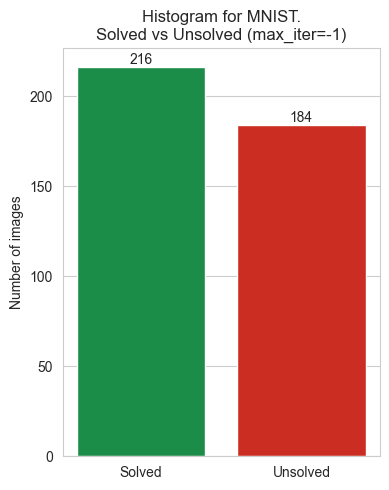

In [15]:
hist_solved_unsolved(MNIST_df, 'MNIST')

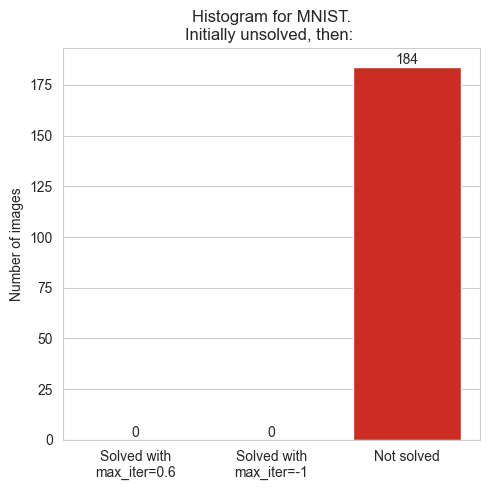

In [16]:
hist_sol_with_greater_max_iter(MNIST_df, 'MNIST')

## CIFAR-10

In [17]:
# Loading dataset
CIFAR10_df = pd.read_pickle("Data_Collected/CIFAR10_df.pkl")

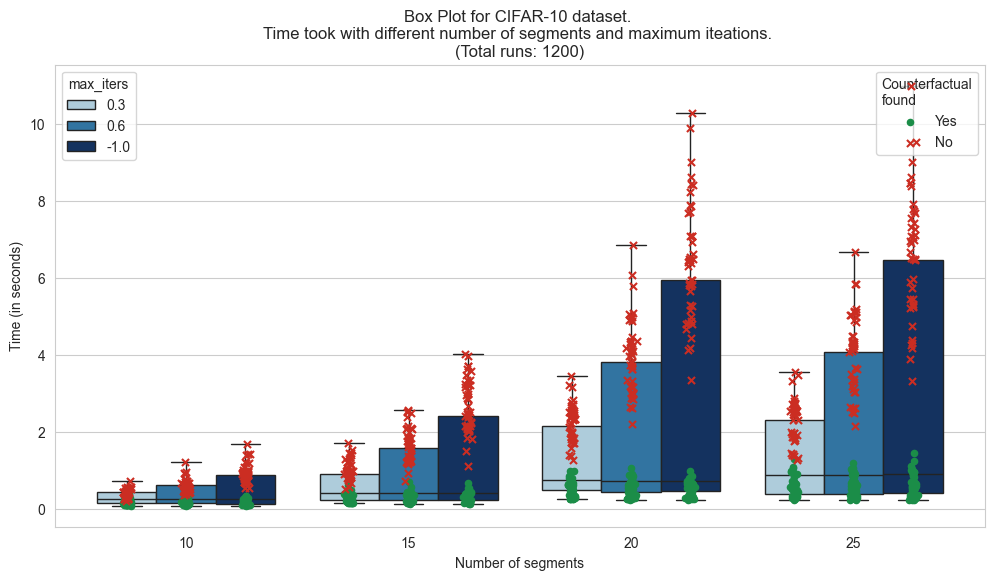

In [18]:
box_plot_all(CIFAR10_df, "CIFAR-10")

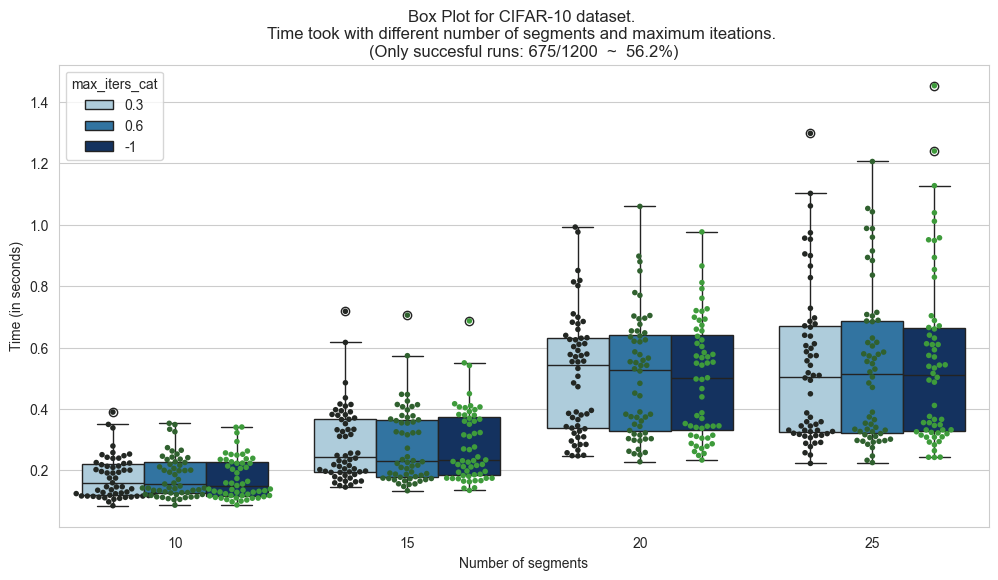

In [19]:
box_plot_successfull(CIFAR10_df, "CIFAR-10")

In [14]:
CIFAR10_visualize_df = visualize_dataset(CIFAR10_df)

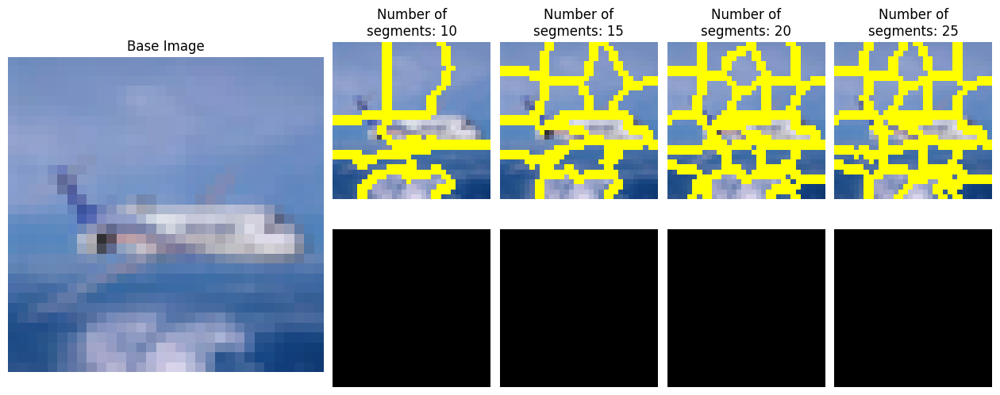

In [87]:
visualize_img_seg_edc(2, CIFAR10_visualize_df)

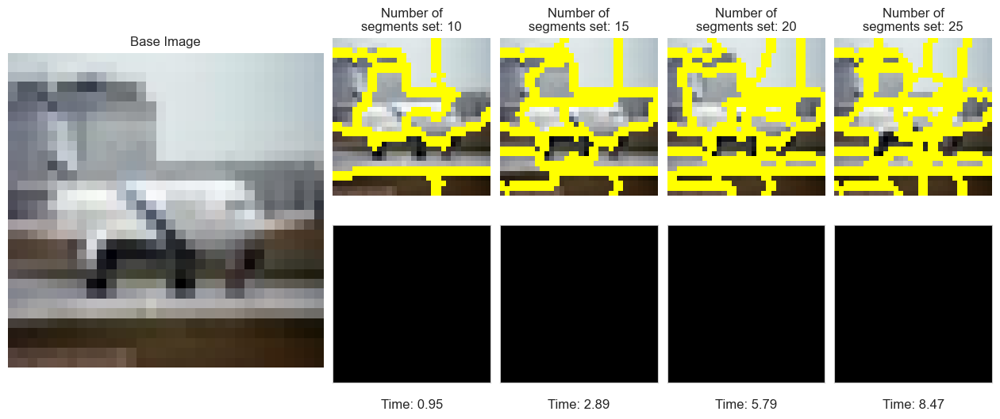

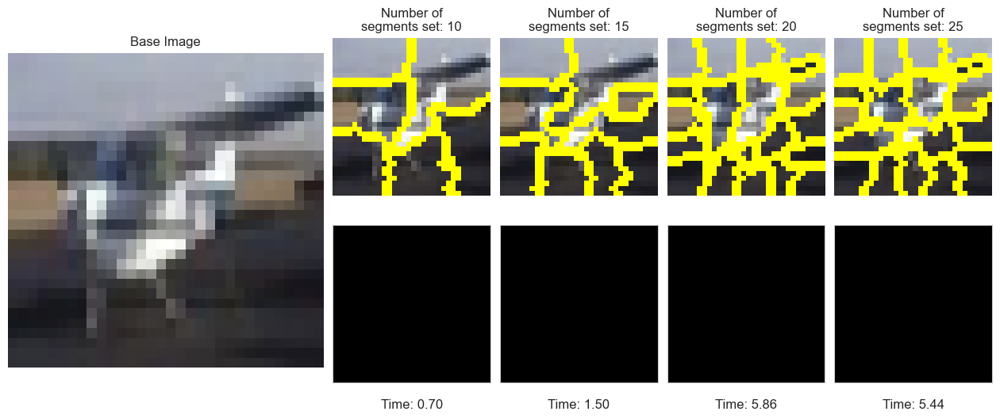

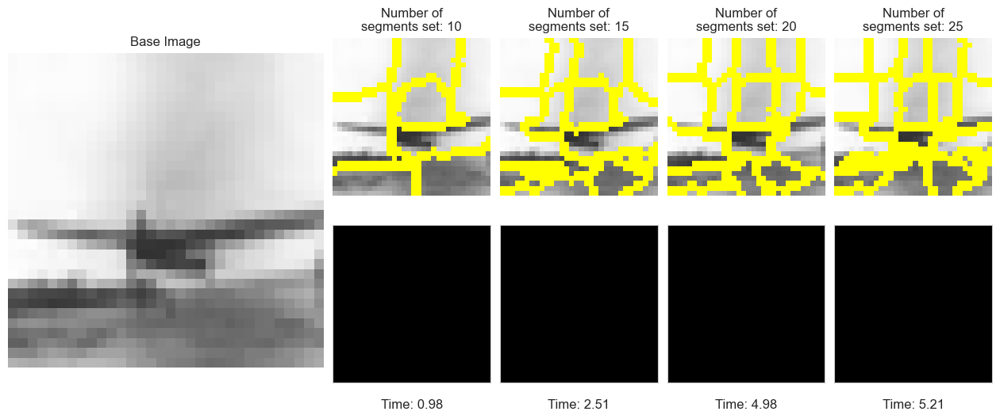

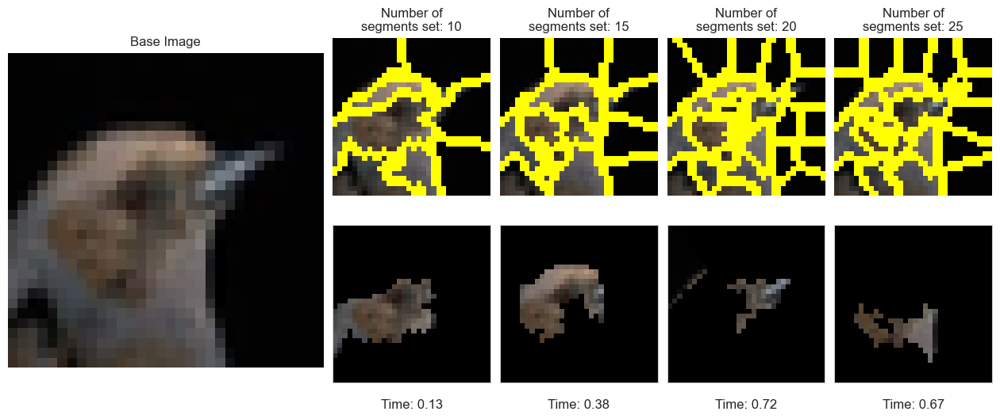

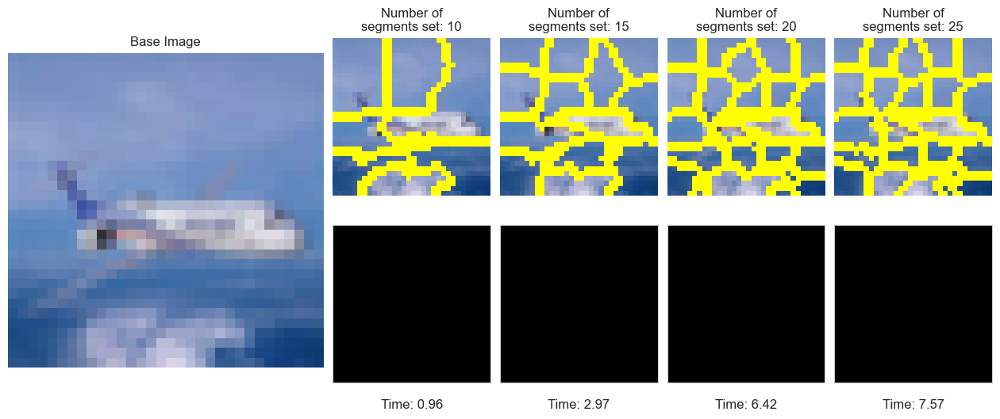

...

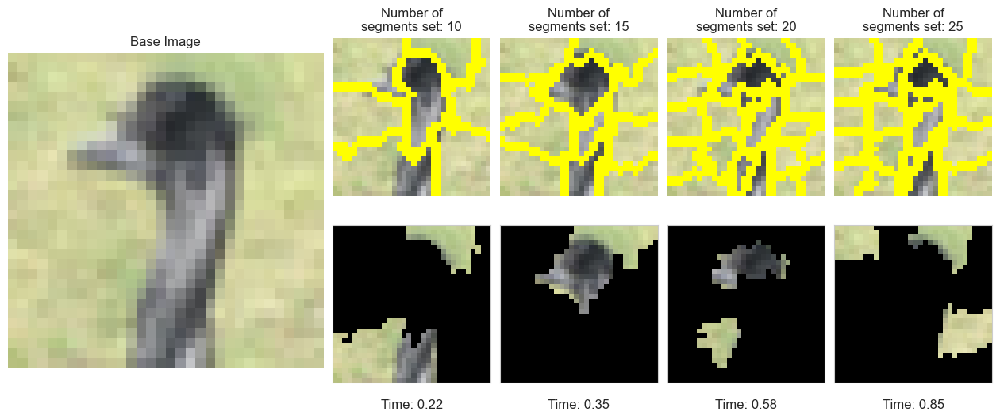

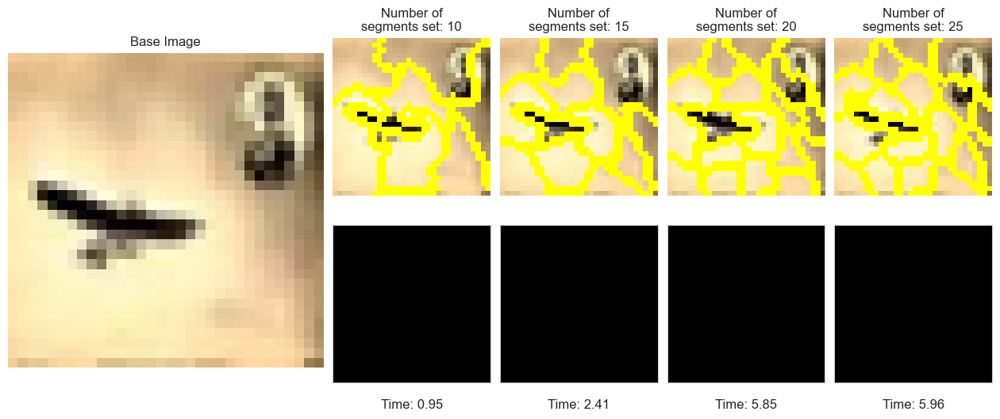

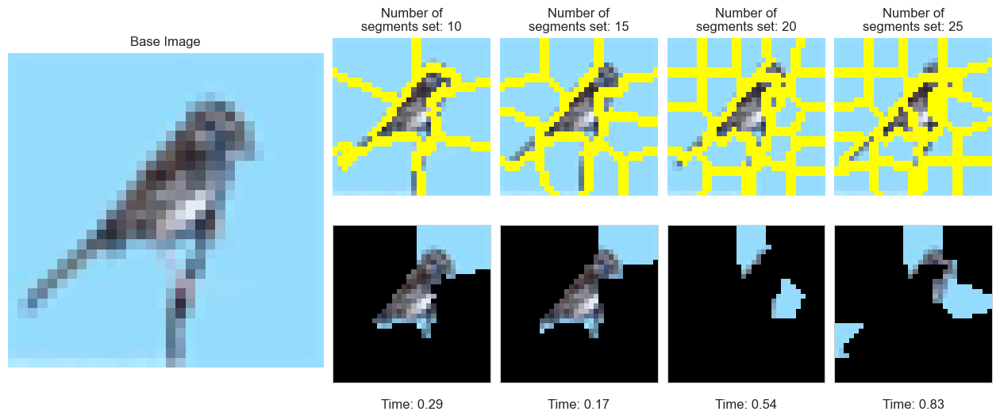

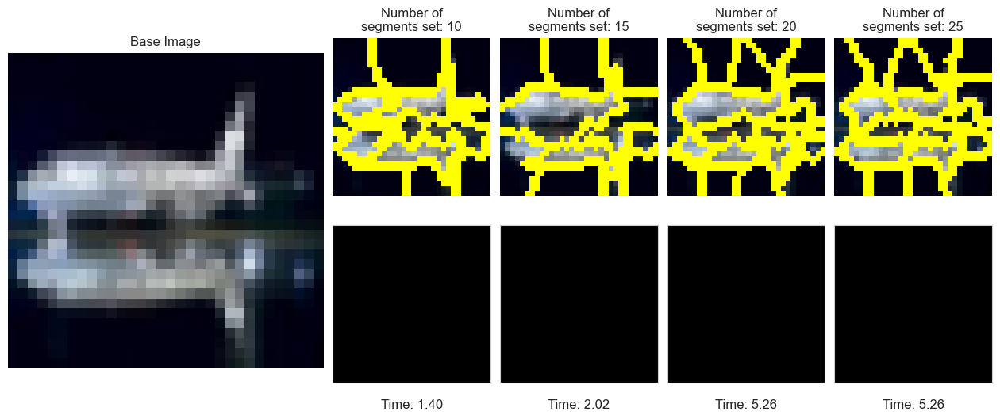

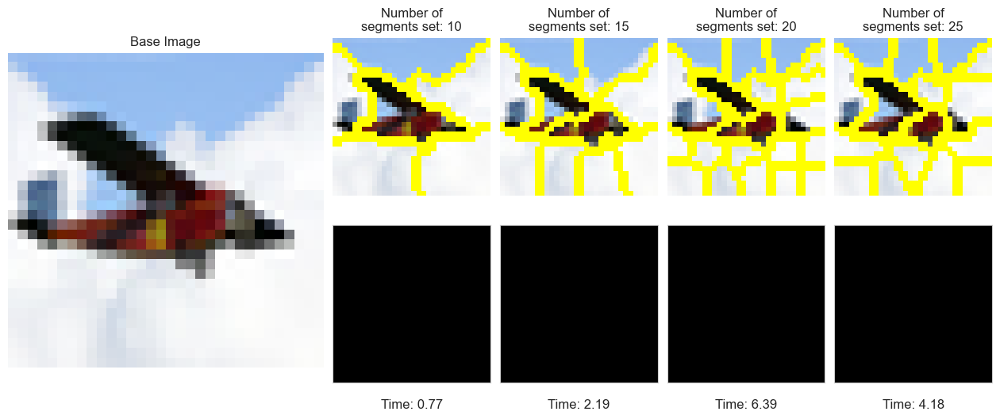

In [15]:
for i in range(30):
    visualize_img_seg_edc(i, CIFAR10_visualize_df)

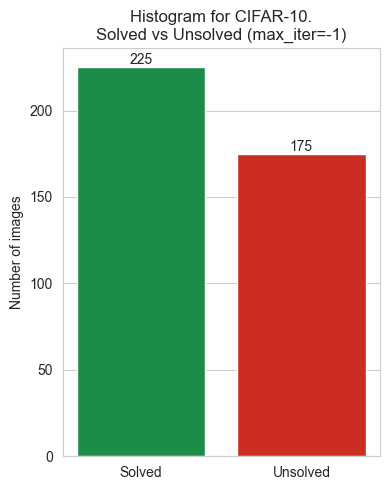

In [20]:
hist_solved_unsolved(CIFAR10_df, 'CIFAR-10')

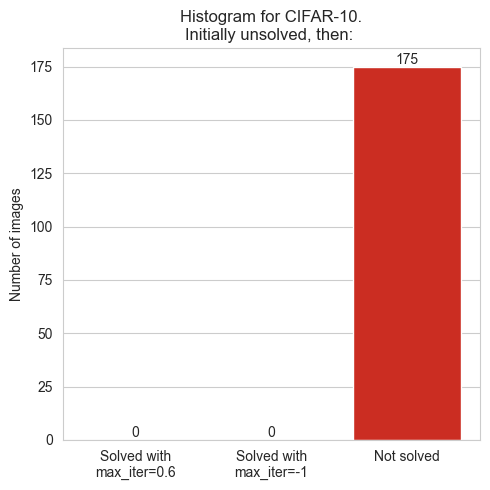

In [21]:
hist_sol_with_greater_max_iter(CIFAR10_df, 'CIFAR-10')

## CatsVsDogs

In [22]:
CATSDOGS_df = pd.read_pickle("Data_Collected/CATSDOGS_df.pkl")

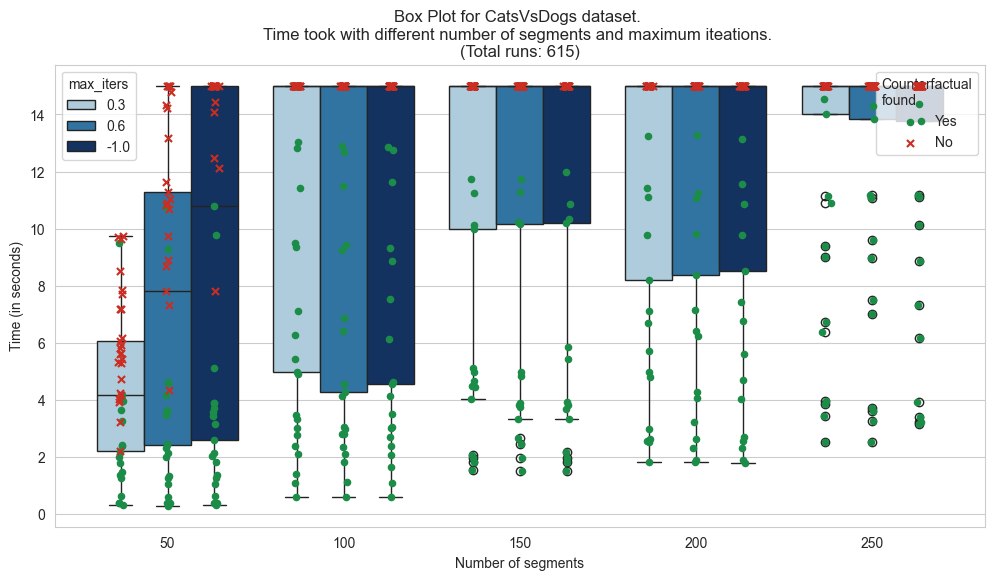

In [23]:
box_plot_all(CATSDOGS_df, 'CatsVsDogs')

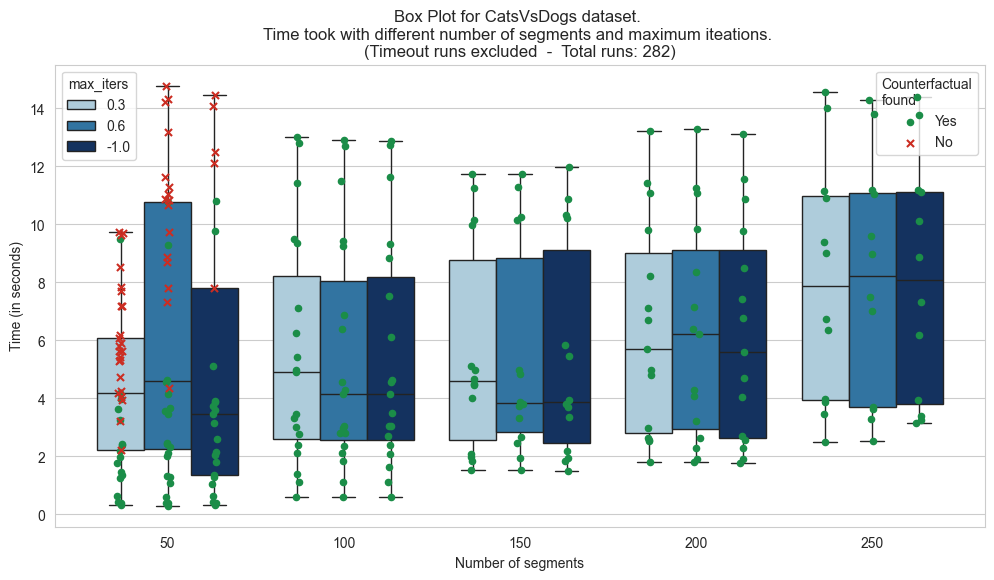

In [24]:
box_plot_all(CATSDOGS_df, 'CatsVsDogs', exclude_timeout=True)

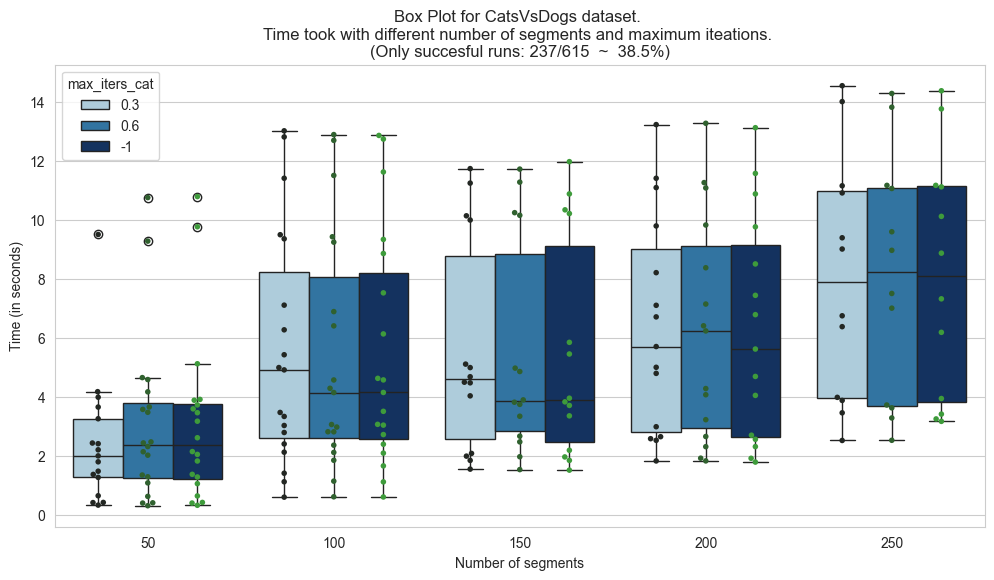

In [25]:
box_plot_successfull(CATSDOGS_df, 'CatsVsDogs')

In [18]:
CATSDOGS_visualize_df = visualize_dataset(CATSDOGS_df, only_med=True)

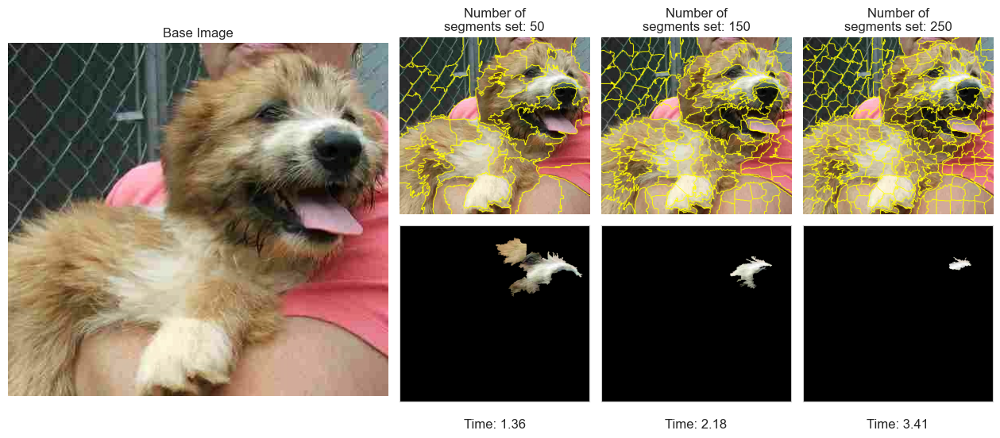

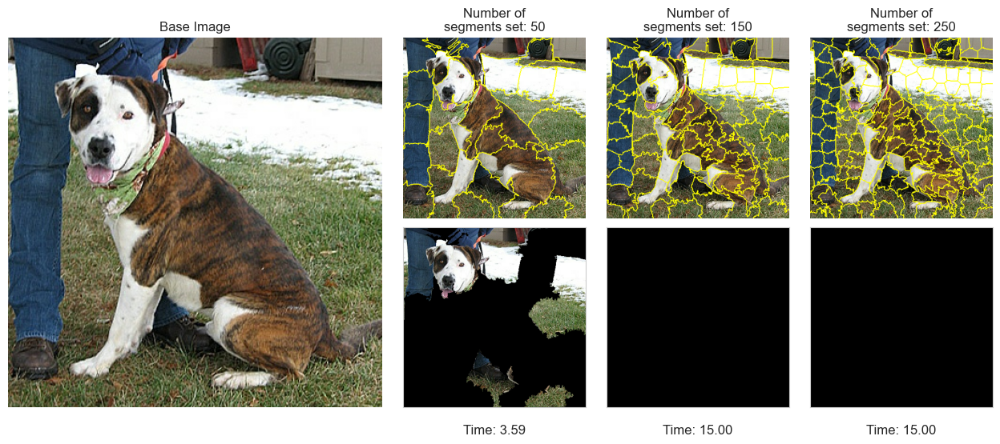

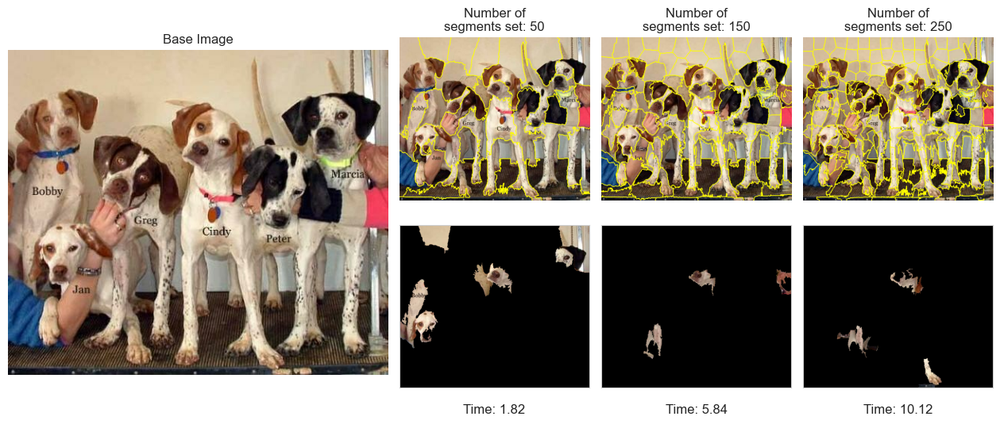

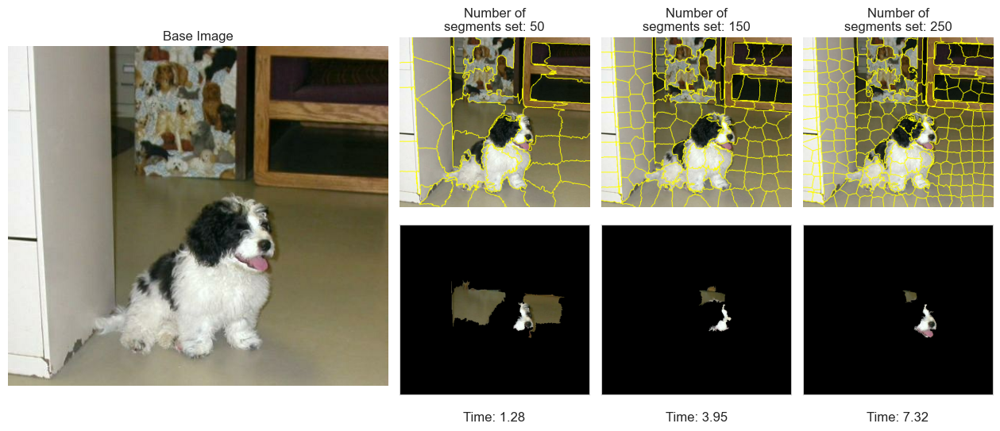

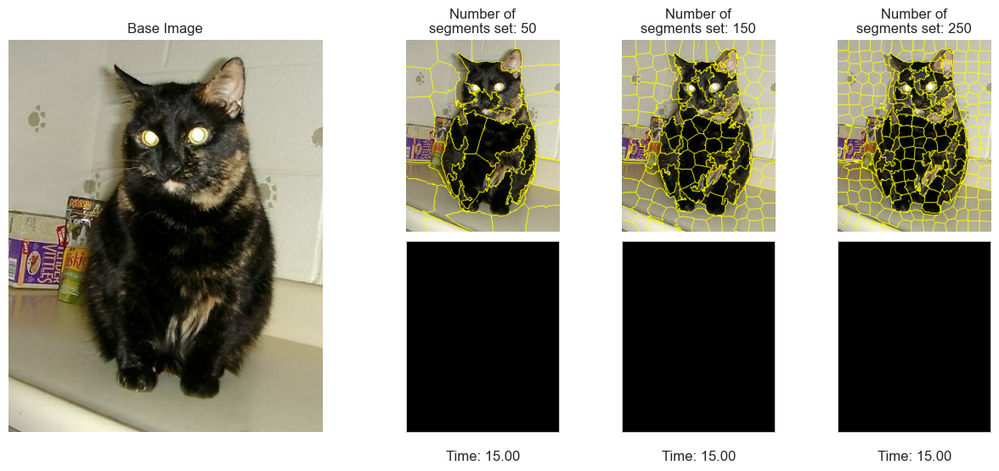

...

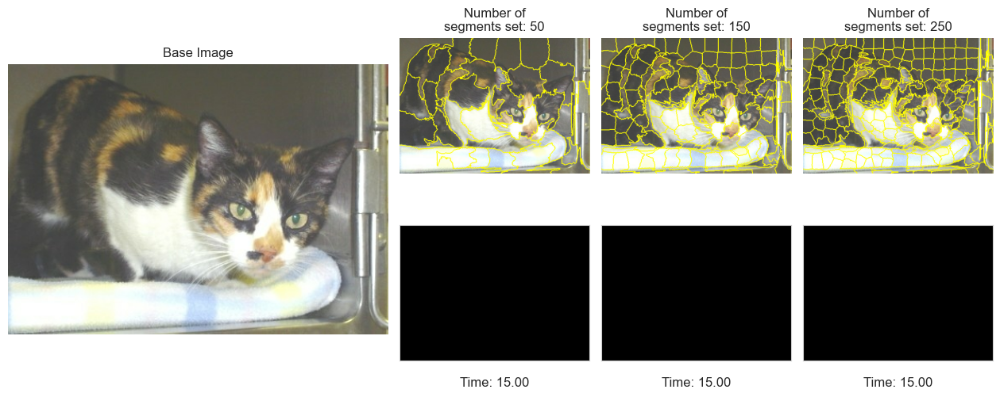

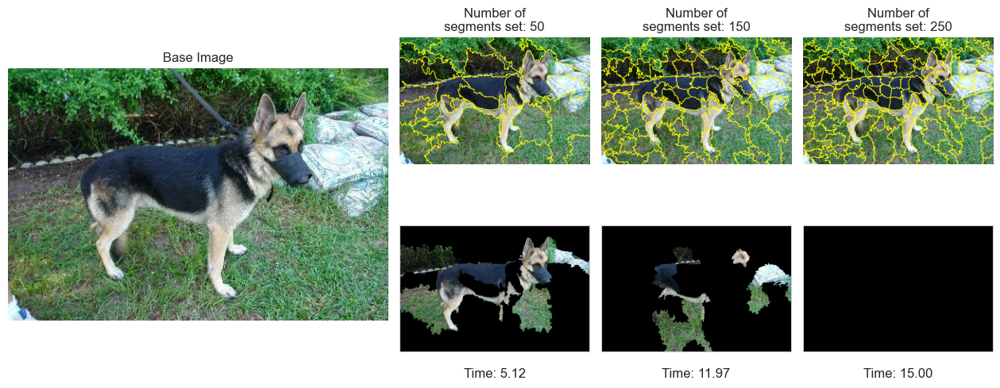

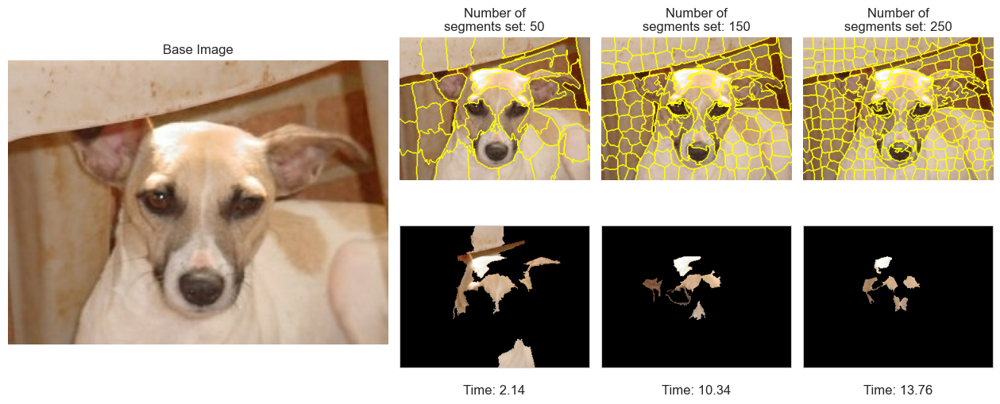

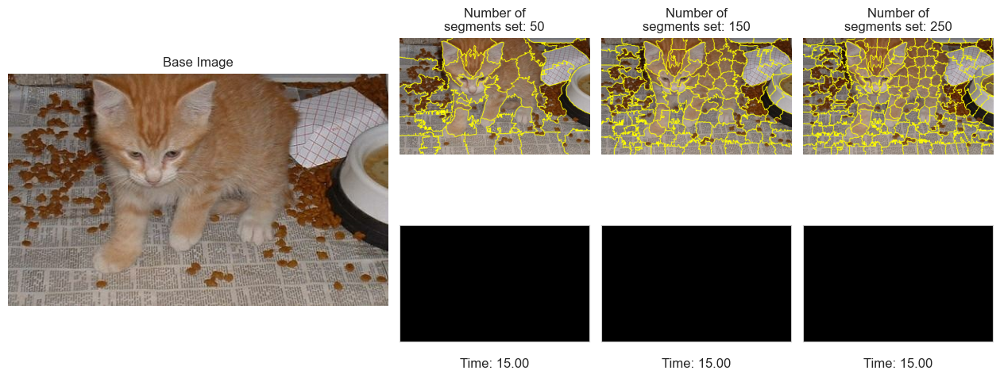

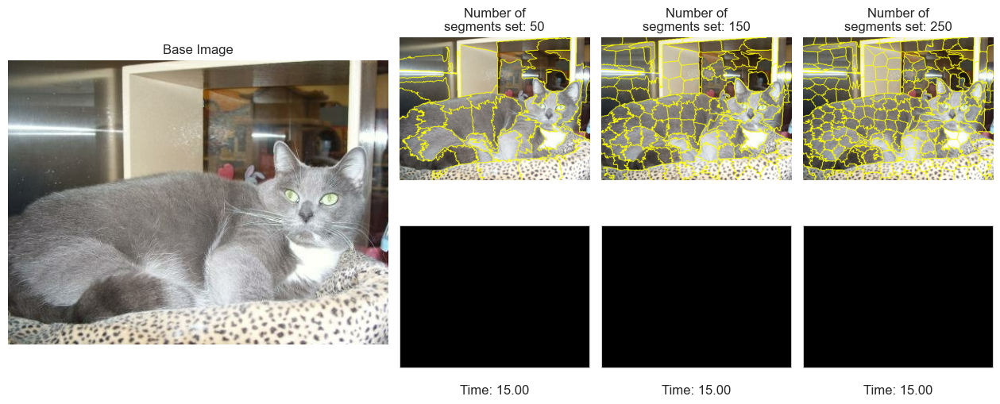

IndexError: single positional indexer is out-of-bounds

In [ ]:
for i in range(41):
    visualize_img_seg_edc(i, CATSDOGS_visualize_df)

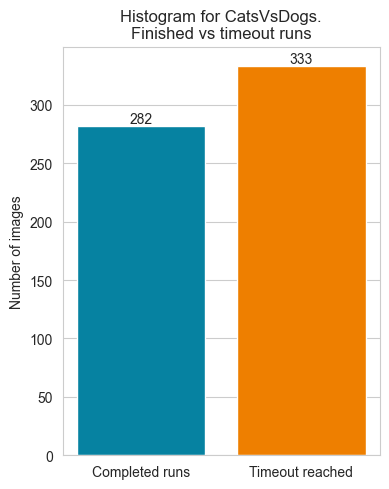

In [37]:
hist_run_timedout(CATSDOGS_df, 'CatsVsDogs')

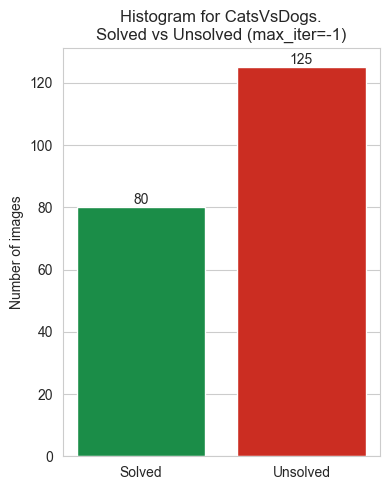

In [33]:
hist_solved_unsolved(CATSDOGS_df, 'CatsVsDogs')

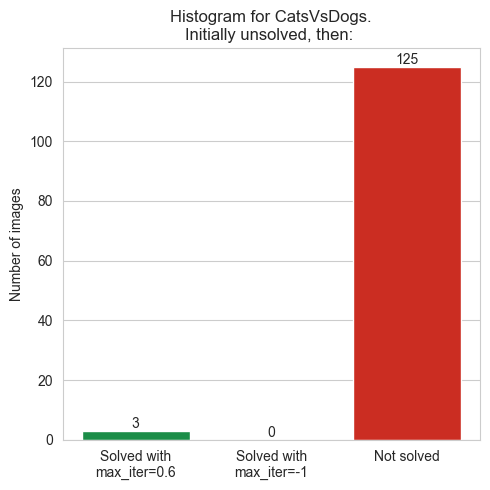

In [28]:
hist_sol_with_greater_max_iter(CATSDOGS_df, 'CatsVsDogs')

/var/folders/vx/wsv0__k15g37xmltv38_43l80000gn/T/ipykernel_95817/2902115708.py:23: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df.fillna(False, inplace=True)


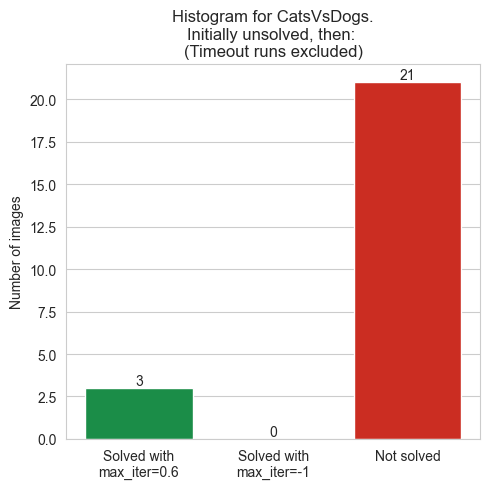

In [29]:
hist_sol_with_greater_max_iter(CATSDOGS_df, 'CatsVsDogs', exclude_timeout=True)